In [1]:
import velvetvae as vt

# general packages
import numpy as np
import pandas as pd
import torch
from scipy.sparse import issparse

# velocity packages
import scanpy as sc
import scvelo as scv
import anndata as ann

# plotting packages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm, trange
from IPython.display import clear_output

# color palette object
from colors import colorpalette as colpal

Global seed set to 0
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
from cellrank.kernels import PseudotimeKernel
import scFates as scf

# Labelling data

In [4]:
adata0 = vt.pp.read("../../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

In [3]:
def process_for_pseudotime(adata, layer, n_neighbors=50):
    X = adata.layers[layer]
    X = X.A if issparse(X) else X
    
    Xlog = np.log1p(X)
    pca = PCA()
    Xpca = pca.fit_transform(Xlog)
    adata.obsm['X_pca'] = Xpca
    adata.varm['precomputed_PCs'] = pca.components_
    
    if n_neighbors > 0:
        cnx = vt.pp.connectivities(total=X, n_neighbors=n_neighbors)
        Xsmooth = vt.pp.moments(X=X, cnx=cnx, n_neighbors=n_neighbors)
        Xlogsmooth = np.log1p(Xsmooth)
        pca = PCA()
        Xpcasmooth = pca.fit_transform(Xlogsmooth)
        adata.obsm['X_pca_smooth'] = Xpcasmooth
    else:
        adata.obsm['X_pca_smooth'] = Xpca
    return adata

def run_tree(
    adata, 
    layer,
    n_nodes=200,
    seed=1,
    ppt_lambda=50,
    ppt_sigma=1.5,
    ndims_rep=50,
    figsize=(9,4),
    dimensions=[[0,1],[0,2]],
    color='cell_annotation'
    ):
    scf.tl.tree(adata, method="ppt",Nodes=n_nodes, use_rep="X_pca_smooth",
                device="cpu",seed=seed,ppt_lambda=ppt_lambda,ppt_sigma=ppt_sigma,
                ppt_nsteps=300, ndims_rep=ndims_rep)
    fig = plt.figure(figsize=figsize)
    ax1, ax2 = fig.subplots(1,2)
    scf.pl.graph(adata, size=50, color_cells=color, basis='pca', 
                 ax=ax1, dimensions=dimensions[0], show=False, forks=False)
    scf.pl.graph(adata, size=50, color_cells=color, basis='pca', 
                 ax=ax2, dimensions=dimensions[1], show=False, forks=False)
    print(f"Tips: {adata.uns['graph']['tips']}")
    print()
    print(f"Forks: {adata.uns['graph']['forks']}")
    plt.show()

def run_pseudotime(adata, root, n_maps=10):    
    scf.tl.root(
        adata,
        root
    )

    scf.tl.pseudotime(
        adata,
        n_jobs=20,
        n_map=n_maps,
        seed=42
    )
    adata.obs['seg'] = adata.obs['seg'].astype('category')
    scf.pl.trajectory(adata, basis='pca', color_cells='seg')

def get_cell_pseudotime_vector(adata, cell_idx, basis='pca', ndim=50):
    idx = adata.uns['graph']['pp_info'].sort_values('time').PP.values
    points = adata.uns['graph']['F'].T[idx]
    segs = adata.uns['graph']['pp_info'].seg.values[idx]
    
    
    cell = adata[cell_idx]
    cell_rep = cell.obsm[f'X_{basis}'][:,:ndim]
    cell_seg = cell.obs.seg.values[0]
    
    seg_points = points[segs==cell_seg][:,:ndim]
    best = np.sqrt(np.sum((cell_rep - seg_points)**2, axis=1)).argmin()
    try:
        vector = seg_points[best+1] - seg_points[best]
    except IndexError:
        vector = np.zeros_like(seg_points[best])
    return vector

def calculate_pseudotime_vectorfield(adata, ndim=50, basis='pca'):
    vf = np.zeros_like(adata.obsm[f"X_{basis}"][:,:ndim])
    for i in trange(adata.shape[0]):
        vf[i,:] = get_cell_pseudotime_vector(adata, cell_idx=i, basis=basis, ndim=ndim)
    adata.obsm['velocity_pst'] = vf
    adata.obsm['X_pst'] = adata.obsm[f"X_{basis}"][:,:ndim]
    
def viz(adata, genes):
    """
    we don't want to keep the log transformed data or PCA, but want to viz
    """
    copy = adata.copy()    
    sc.pp.log1p(copy)
    sc.pp.pca(copy)
    sc.pl.pca(copy, color=['cell_annotation','timepoint','rep'])
    
def calculate_cellrank_vectorfield(adata, ndim=50, basis='pca'):
    cnx = vt.pp.connectivities(total=adata.layers['total'], n_neighbors=30)
    adata.obsp['neighbors_connectivities'] = cnx
    pk = PseudotimeKernel(adata, time_key='t')
    pk.compute_transition_matrix()
    pk.plot_projection(basis='pca', key_added='velocity_cr')
    adata.obsm['X_cr_pca'] = adata.obsm[f"X_{basis}"][:,:ndim]

## 1. mini MN

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


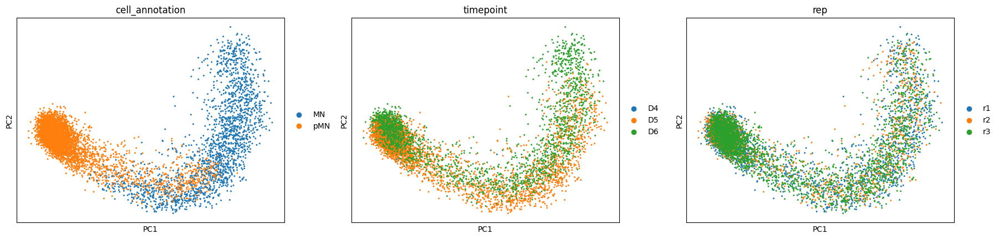

In [31]:
### 1. MN

types = ['MN', 'pMN']
times = ['D4','D5','D6']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]
adata = adata[[tp in times for tp in adata.obs.timepoint]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


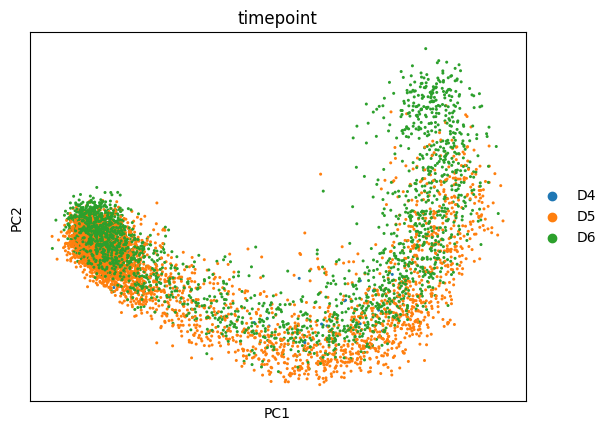

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


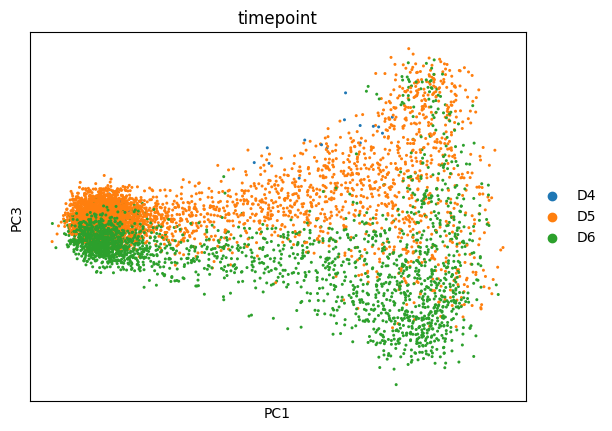

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


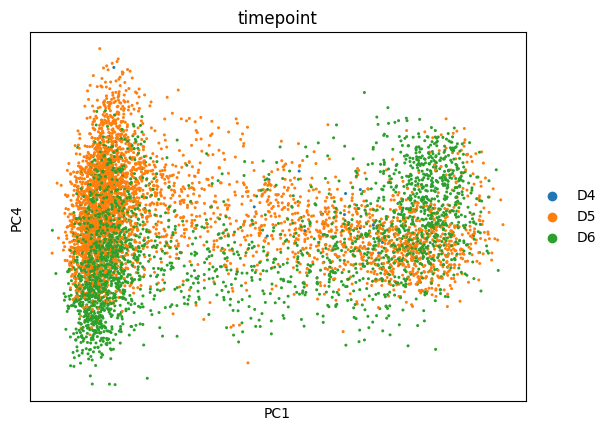

In [34]:
sc.pl.pca(adata, color=['timepoint'], components='1,2')
sc.pl.pca(adata, color=['timepoint'], components='1,3')
sc.pl.pca(adata, color=['timepoint'], components='1,4')

inferring a principal tree --> parameters used 
    100 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:   6%|▌         | 18/300 [00:00<00:12, 22.72it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [21 28 46]

Forks: [3]


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


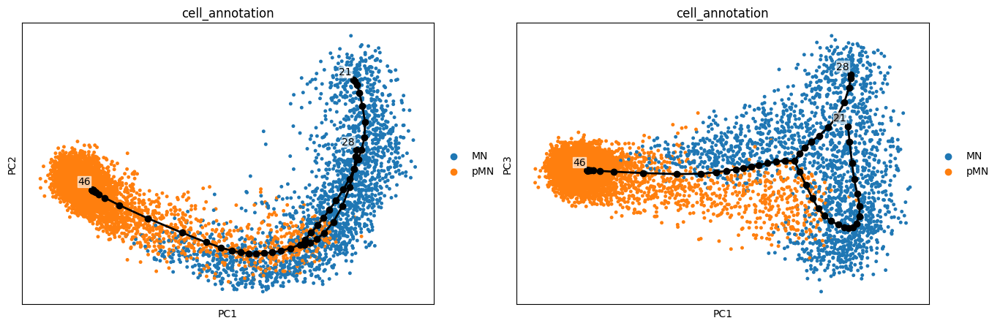

In [69]:
run_tree(
    adata, 
    'total',
    n_nodes=100,
    seed=0,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(16,5)
)

node 46 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:05) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


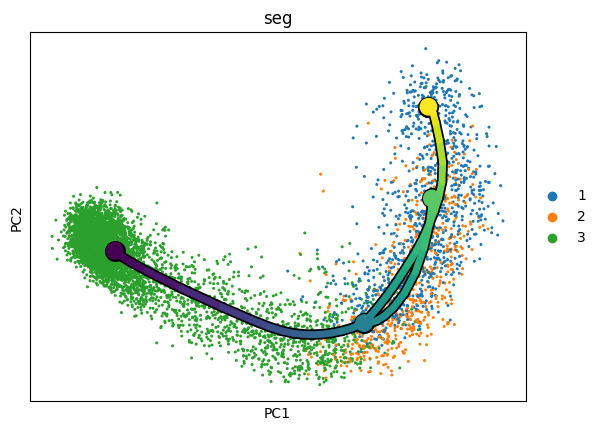

In [70]:
run_pseudotime(adata, root=46, n_maps=1)

In [71]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 6391/6391 [00:21<00:00, 300.29it/s]


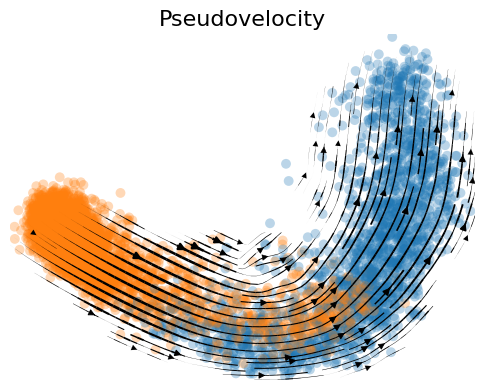

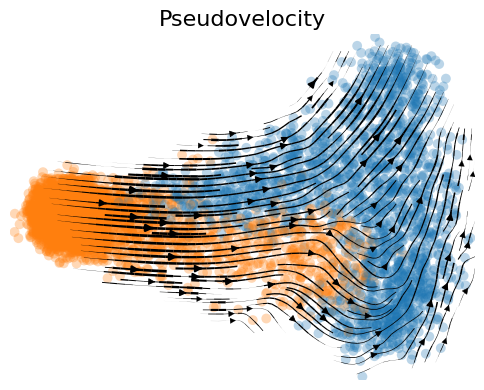

In [72]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

  0%|          | 0/6391 [00:00<?, ?cell/s]

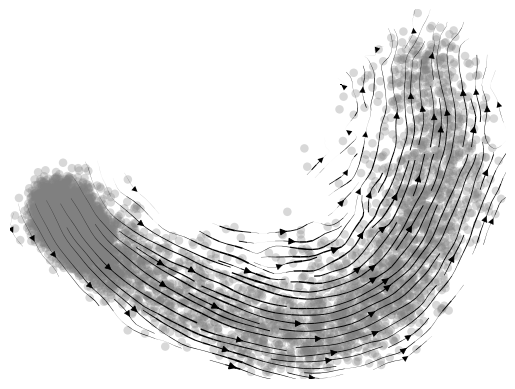

In [76]:
calculate_cellrank_vectorfield(adata)

In [77]:
adata

AnnData object with n_obs × n_vars = 6391 × 1249
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation', 't', 'seg', 'edge', 'milestones'
    uns: 'cell_annotation_colors', 'timepoint_colors', 'rep_colors', 'graph', 'ppt', 'pseudotime_list', 'milestones_colors', 'seg_colors', 'velocity_params', 'velocity_cr_params'
    obsm: 'X_pca', 'X_pca_smooth', 'X_R', 'velocity_pst', 'X_pst', 'velocity_cr_pca', 'X_cr_pca'
    varm: 'precomputed_PCs'
    layers: 'new', 'old', 'total'
    obsp: 'neighbors_connectivities'

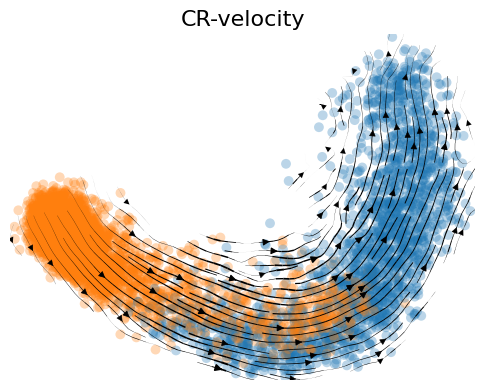

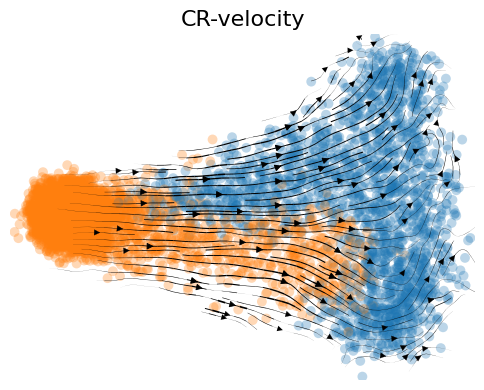

In [81]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [82]:
adata.write_h5ad("../../data/benchmarking/mini_MN.h5ad")

## 2. mini V3

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


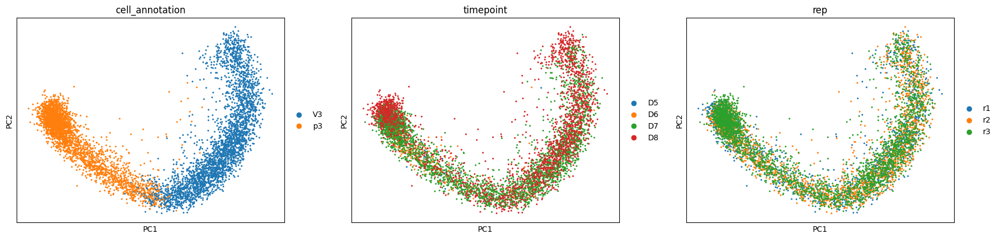

In [83]:
### 2. V3

types = ['V3', 'p3']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


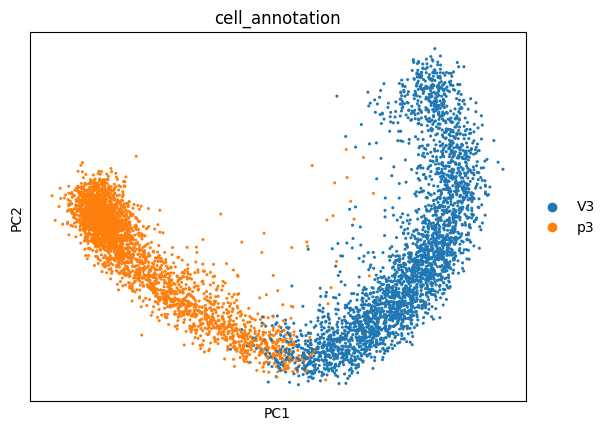

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


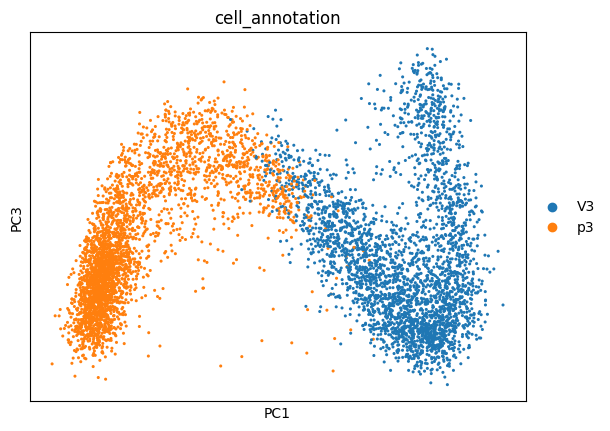

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


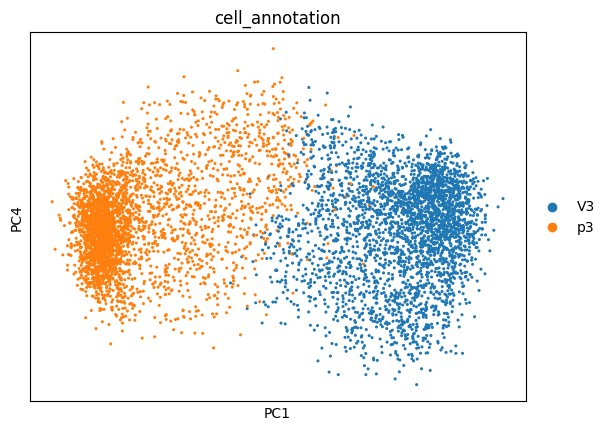

In [84]:
sc.pl.pca(adata, color=['cell_annotation'], components='1,2')
sc.pl.pca(adata, color=['cell_annotation'], components='1,3')
sc.pl.pca(adata, color=['cell_annotation'], components='1,4')

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:  19%|█▉        | 58/300 [00:05<00:23, 10.35it/s]
    converged
    finished (0:00:05) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Tips: [ 87 132]

Forks: []


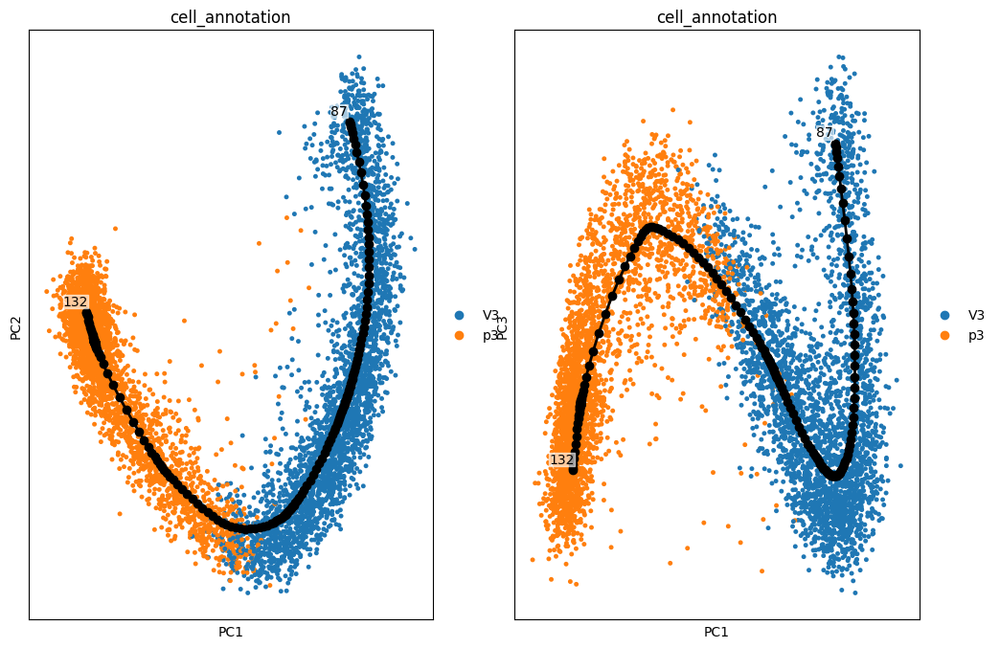

In [85]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(12,8)
)

node 132 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:21<00:00,  8.15s/it]
    finished (0:01:24) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


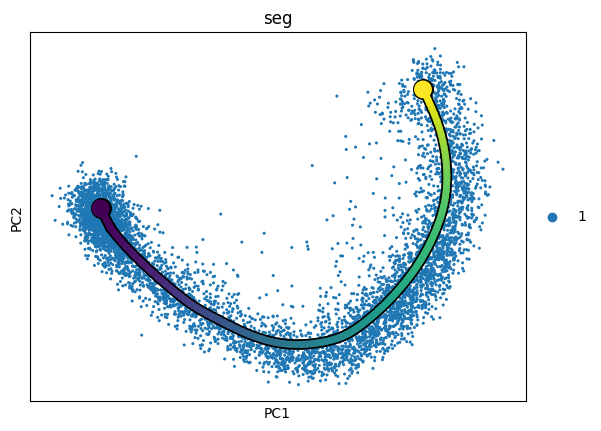

In [88]:
run_pseudotime(adata, root=132)

In [89]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 6172/6172 [00:20<00:00, 295.01it/s]


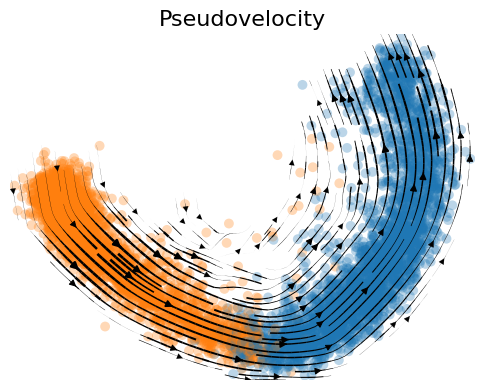

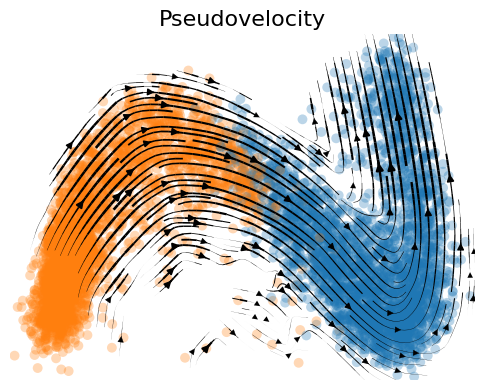

In [90]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

  0%|          | 0/6172 [00:00<?, ?cell/s]

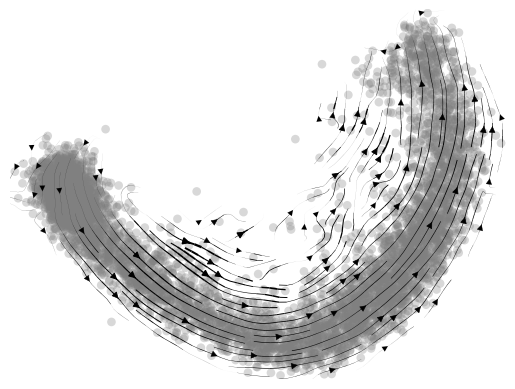

In [91]:
calculate_cellrank_vectorfield(adata)

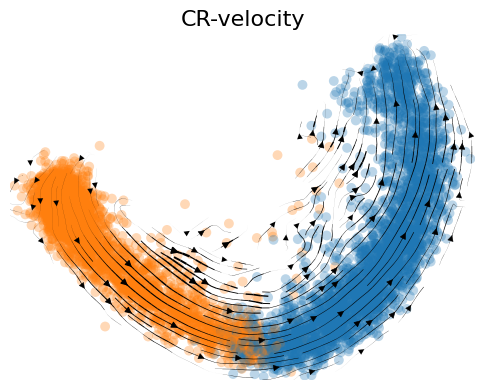

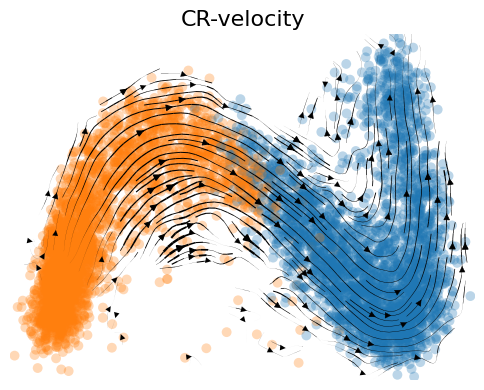

In [92]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [93]:
adata.write_h5ad("../../data/benchmarking/mini_V3.h5ad")

# 3. mini MD

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


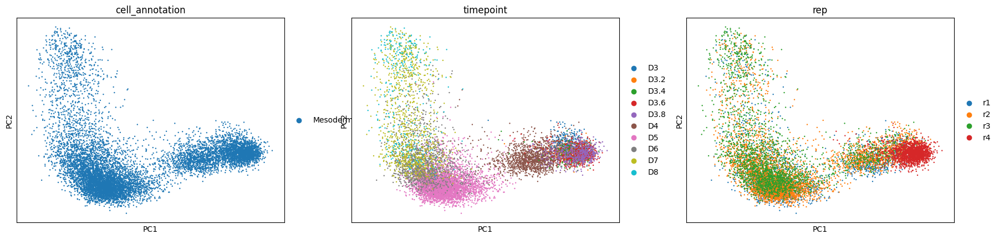

In [94]:
### 3. MD

types = ['Mesoderm']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])


inferring a principal tree --> parameters used 
    200 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:  26%|██▌       | 77/300 [00:08<00:24,  9.08it/s]
    converged
    finished (0:00:08) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [ 82 160 190]

Forks: [166]


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


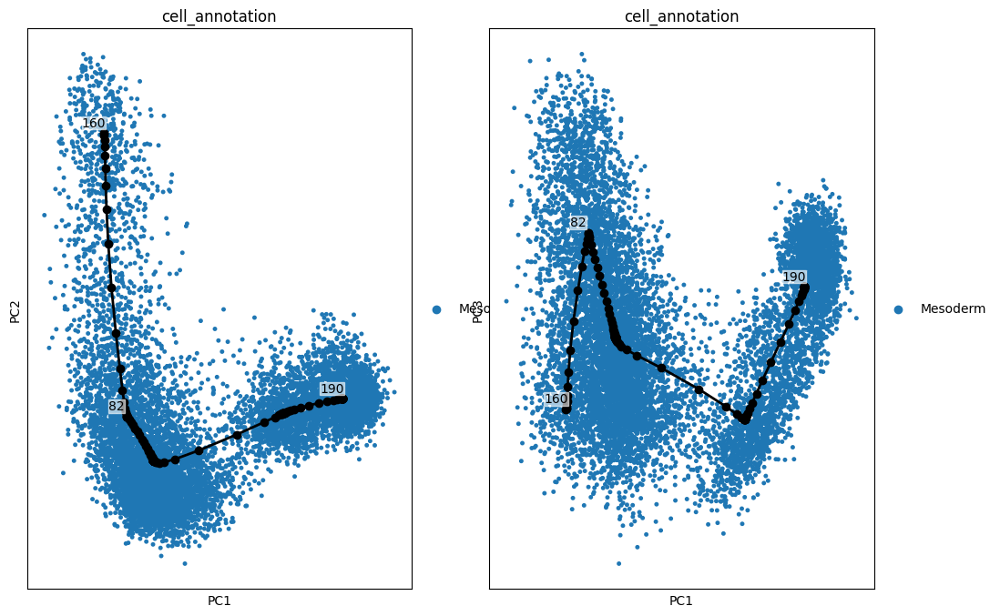

In [95]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(12,8)
)

node 190 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:48<00:00, 10.81s/it]
    finished (0:01:55) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


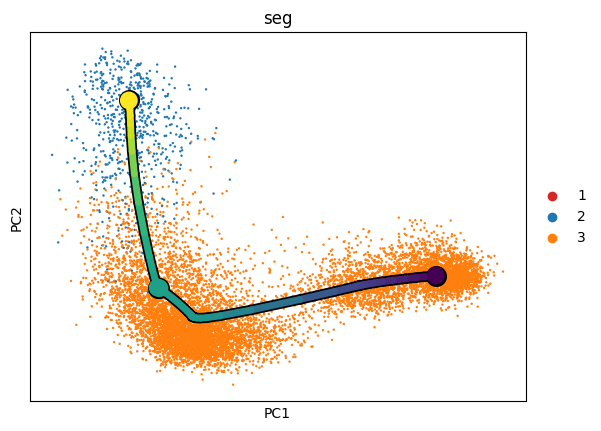

In [96]:
run_pseudotime(adata, root=190)

In [97]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 10024/10024 [00:33<00:00, 296.58it/s]


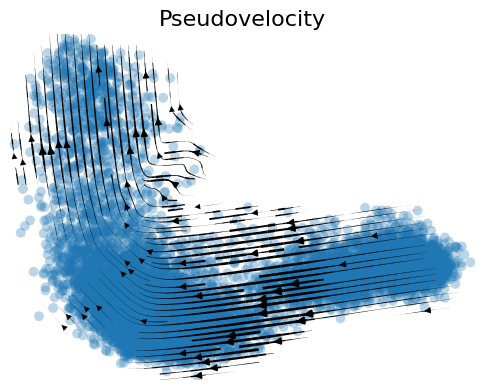

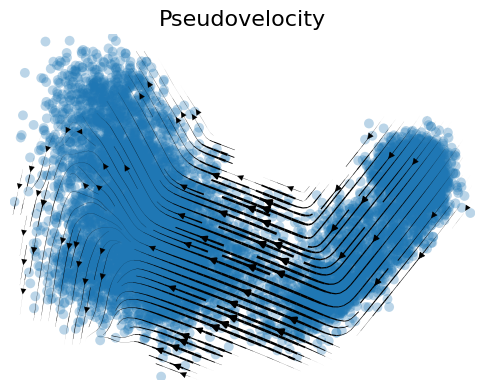

In [98]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

  0%|          | 0/10024 [00:00<?, ?cell/s]

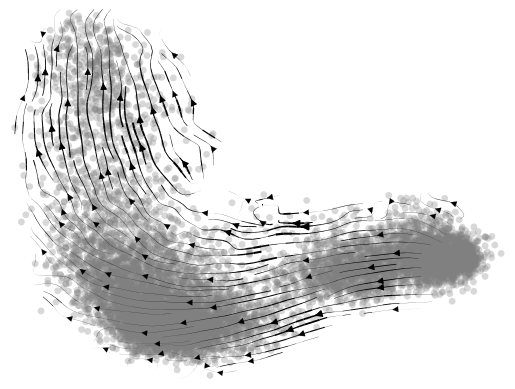

In [99]:
calculate_cellrank_vectorfield(adata)

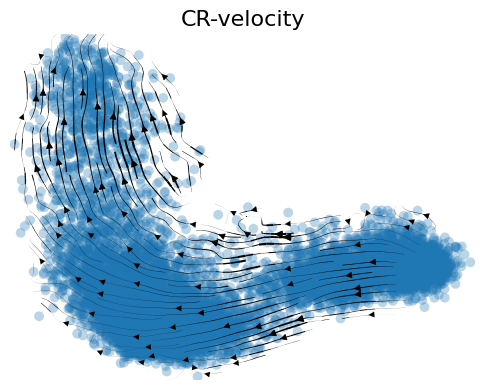

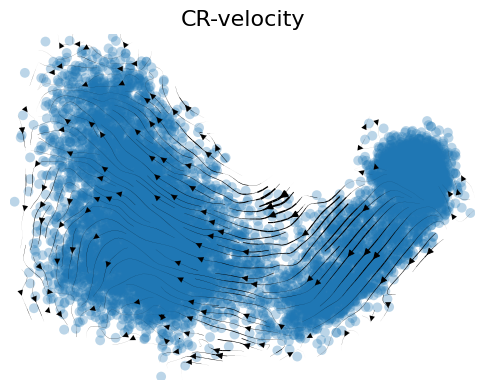

In [100]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CR-velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [101]:
adata.write_h5ad("../../data/benchmarking/mini_MD.h5ad")

# 4. midi NM

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


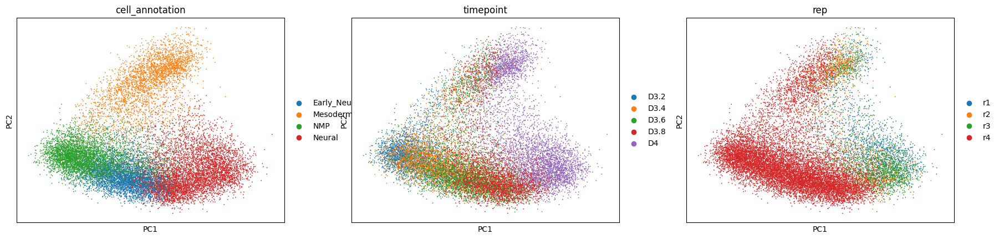

In [102]:
### 1. NM

nt_types = ['MN', 'FP', 'V3', 'p3','pMN']

adata = adata0[[ct not in nt_types for ct in adata0.obs.cell_annotation]]
adata = adata[[tp not in ['D3','D5','D6','D7','D8'] for tp in adata.obs.timepoint]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200, )

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    100 principal points, sigma = 1.2, lambda = 200, metric = euclidean
    fitting:  15%|█▍        | 44/300 [00:04<00:28,  9.05it/s]
    converged
    finished (0:00:05) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Tips: [24 72 80 86]

Forks: [ 6 16]


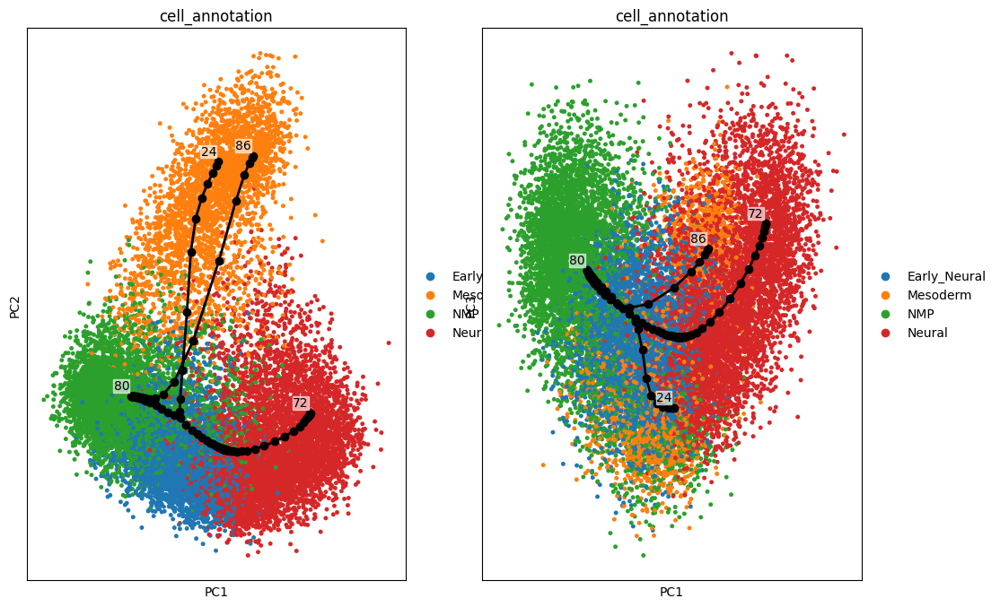

In [108]:
run_tree(
    adata, 
    'total',
    n_nodes=100,
    seed=1,
    ppt_lambda=200,
    ppt_sigma=1.2,
    ndims_rep=50,
    figsize=(12,8)
)

node 80 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:39<00:00,  9.99s/it]
    finished (0:01:53) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


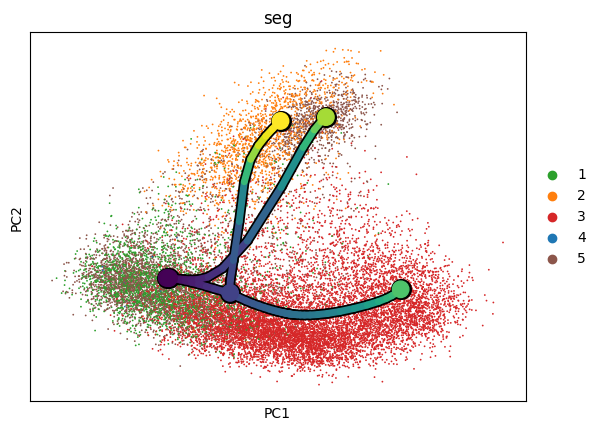

In [109]:
run_pseudotime(adata, root=80)

In [110]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 18185/18185 [01:00<00:00, 298.65it/s]


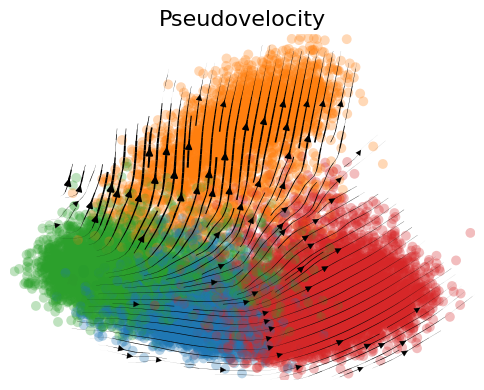

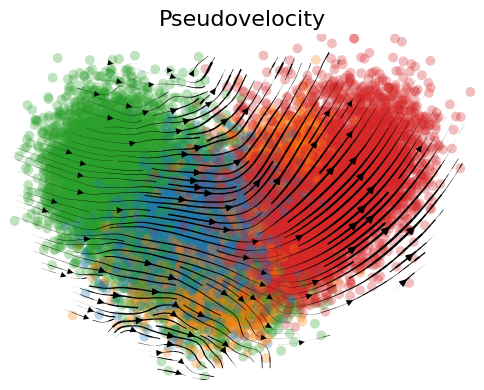

In [111]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

  0%|          | 0/18185 [00:00<?, ?cell/s]

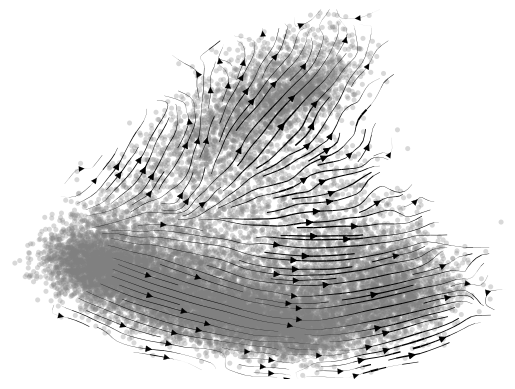

In [112]:
calculate_cellrank_vectorfield(adata)

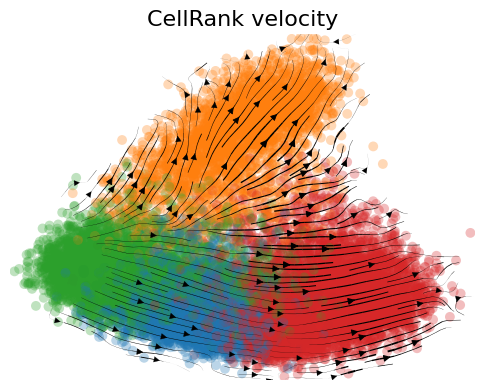

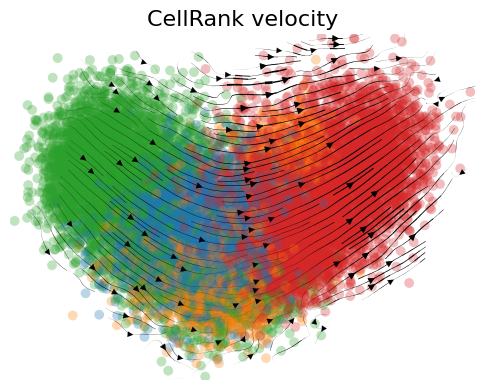

In [113]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

In [114]:
adata.write_h5ad("../../data/benchmarking/midi_NM.h5ad")

# 5. Ne

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


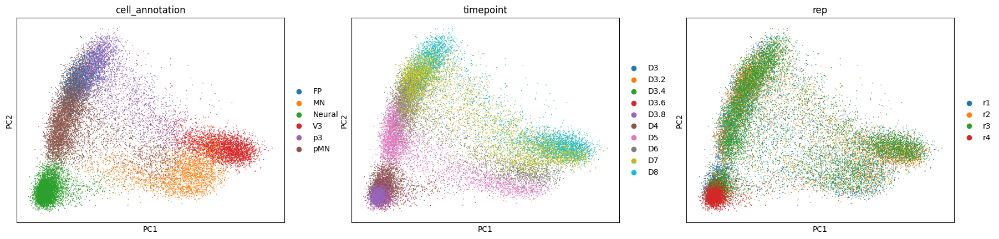

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


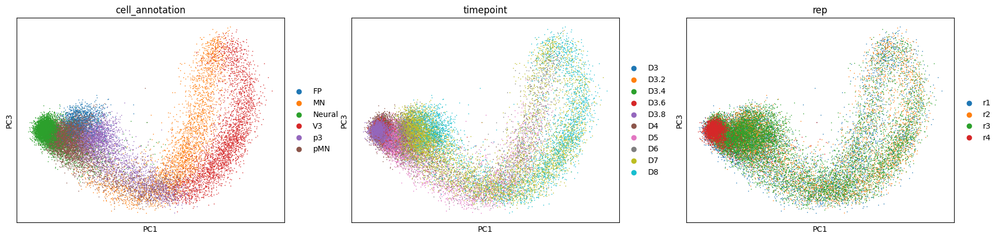

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


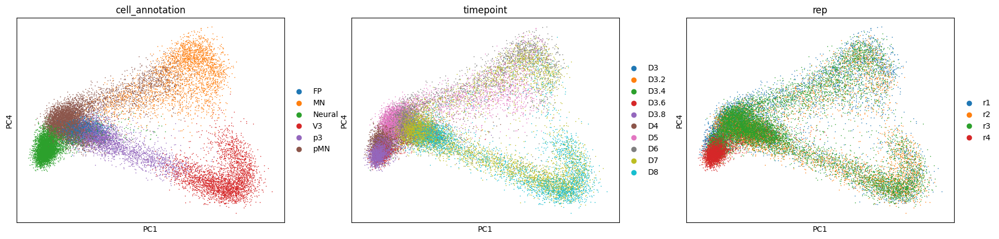

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


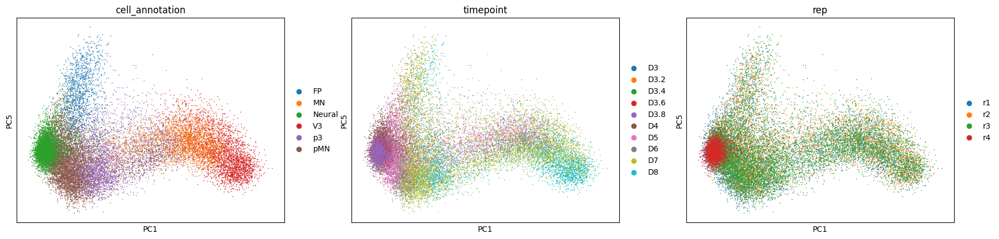

In [115]:
#### 2. Ne
types = ['MN','Neural', 'FP', 'pMN', 'V3', 'p3']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200)

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,2')
sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,3')
sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,4')
sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'], components='1,5')

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2.2, lambda = 800, metric = euclidean
    fitting:  18%|█▊        | 53/300 [00:13<01:03,  3.87it/s]
    converged
    finished (0:00:14) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Tips: [ 15  37  45  83 132]

Forks: [144 147 166]


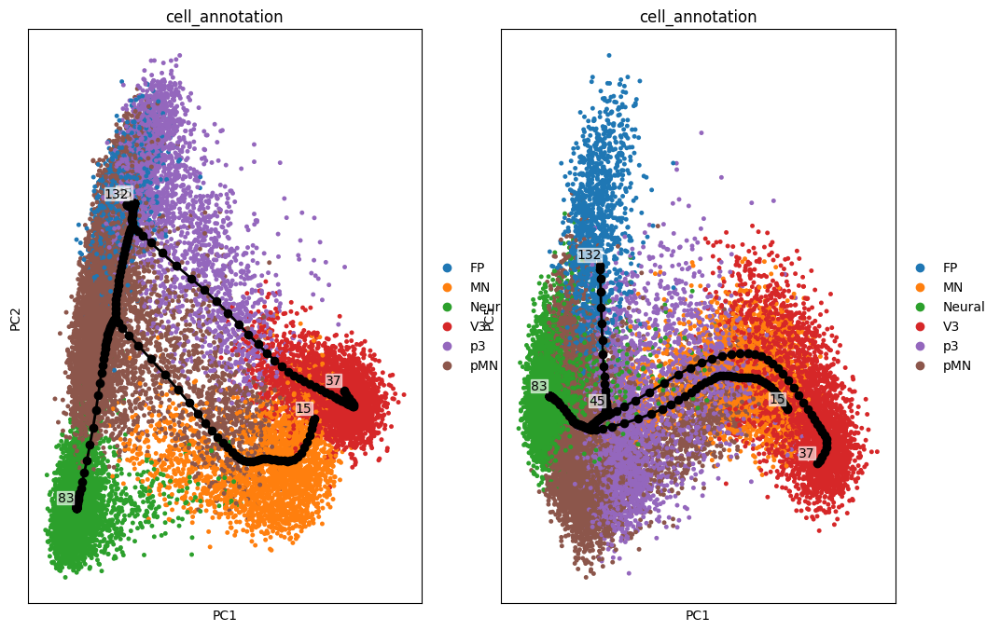

In [119]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=800,
    ppt_sigma=2.2,
    ndims_rep=50,
    figsize=(12,8),
    dimensions=[[0,1],[0,4]]
)

node 83 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [02:12<00:00, 13.26s/it]
    finished (0:02:32) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


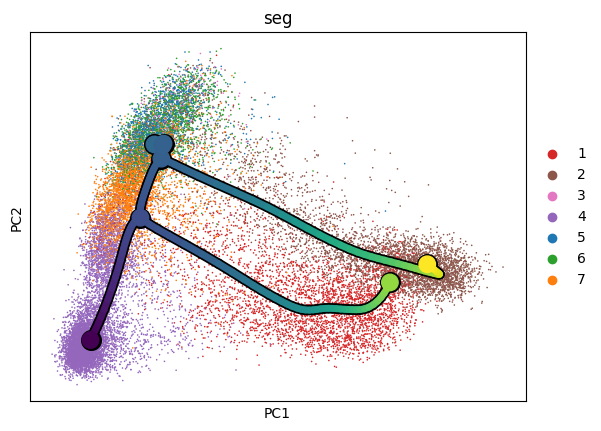

In [120]:
run_pseudotime(adata, root=83)

In [121]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 22413/22413 [01:15<00:00, 296.46it/s]


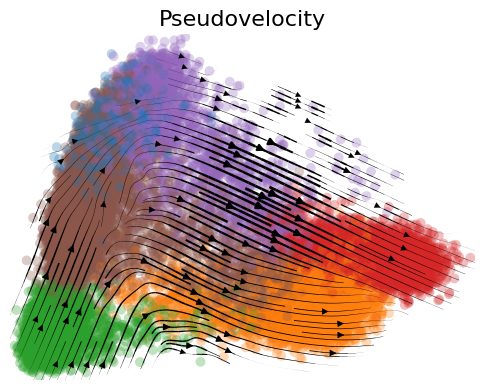

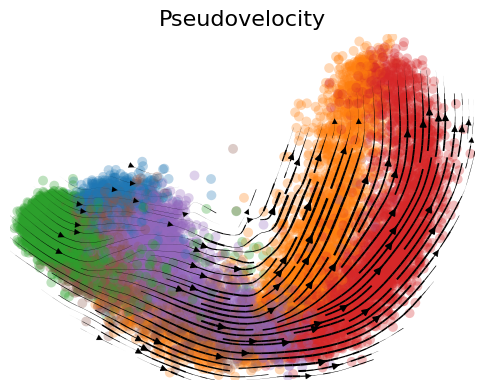

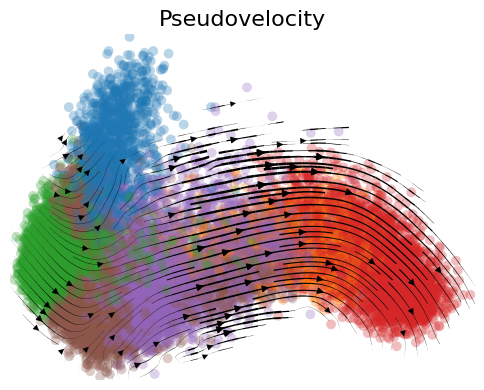

In [123]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,5'
)
plt.show()

  0%|          | 0/22413 [00:00<?, ?cell/s]

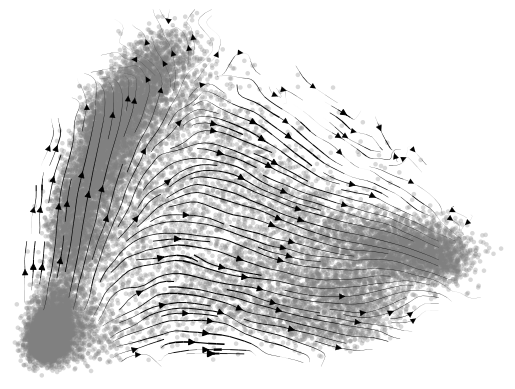

In [124]:
calculate_cellrank_vectorfield(adata)

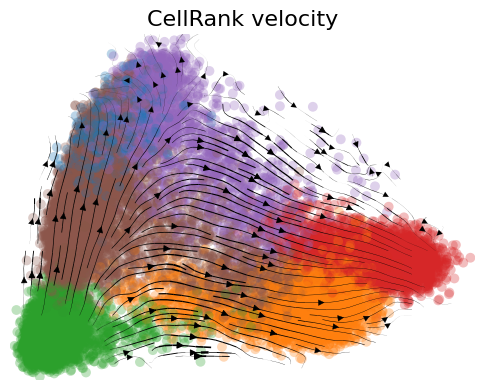

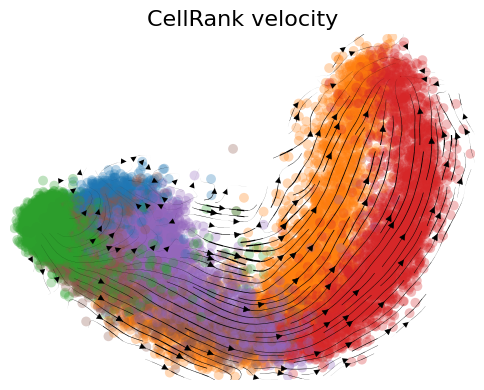

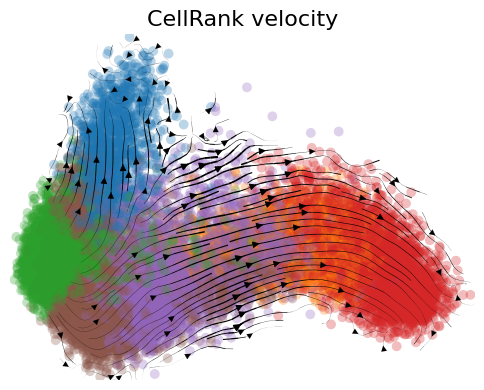

In [125]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,5'
)
plt.show()

In [126]:
adata.write_h5ad("../../data/benchmarking/midi_Ne.h5ad")

# 6. maxi

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


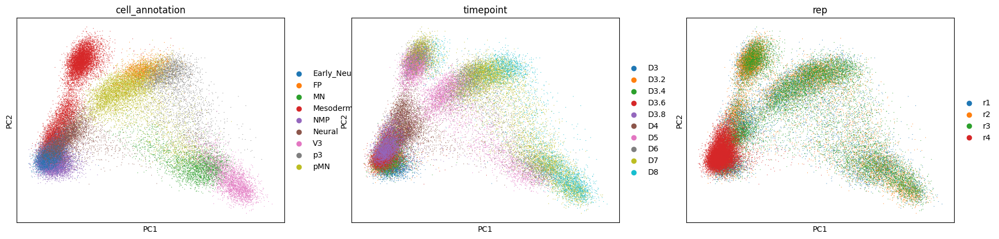

In [127]:
adata = adata0.copy()

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total', n_neighbors=200)

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2.5, lambda = 300, metric = euclidean
    fitting:  18%|█▊        | 53/300 [00:18<01:26,  2.85it/s]
    converged
    finished (0:00:19) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Tips: [  9  35  56  89 137]

Forks: [ 68  93 106]


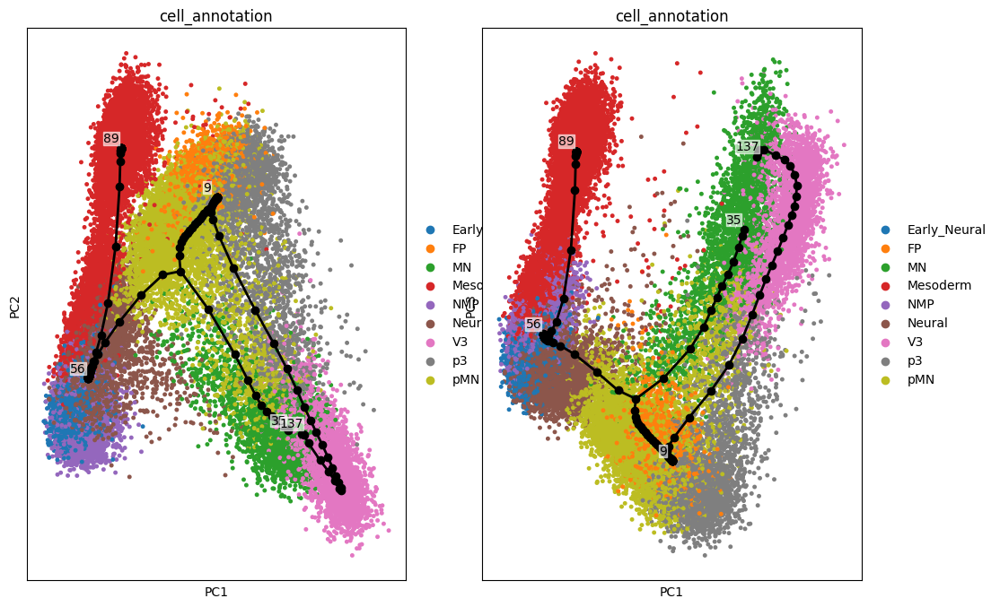

In [139]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=300,
    ppt_sigma=2.5,
    ndims_rep=50,
    figsize=(12,8)
)

node 56 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [03:07<00:00, 18.70s/it]
    finished (0:03:50) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


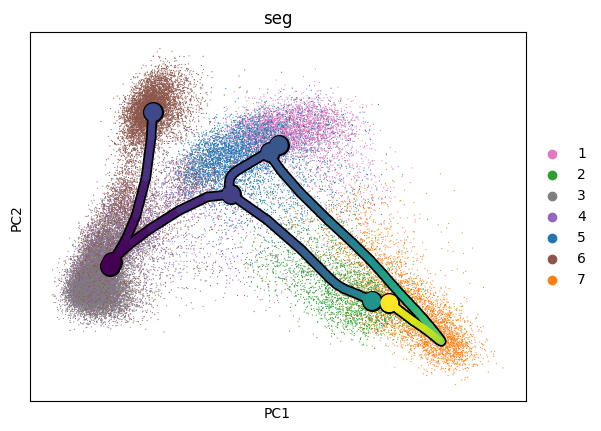

In [140]:
run_pseudotime(adata, root=56)

In [141]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 44713/44713 [02:31<00:00, 295.55it/s]


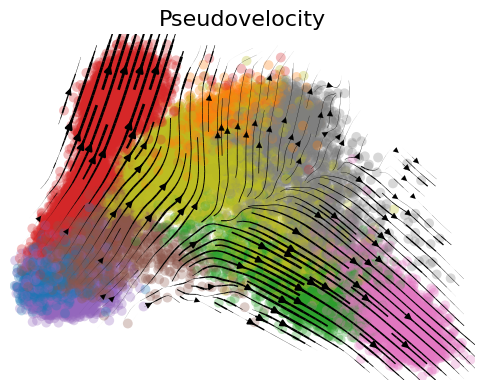

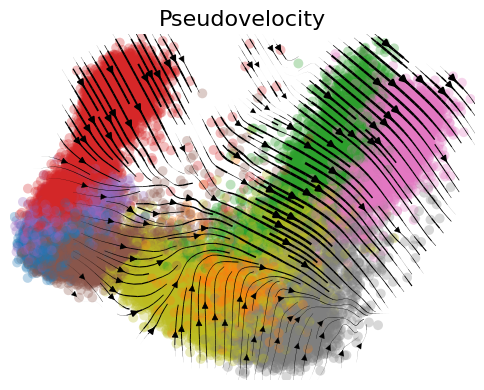

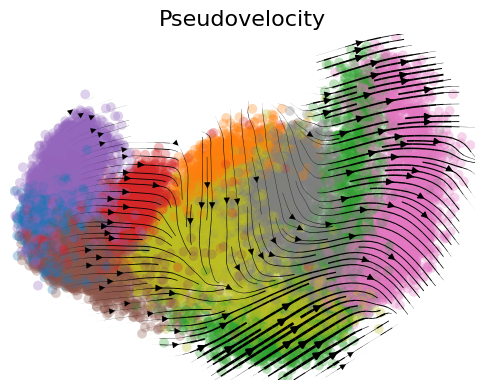

In [142]:
adata.uns["velocity_params"] = {'embeddings':'pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudovelocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,4'
)
plt.show()

This isn't good enough to use.

  0%|          | 0/44713 [00:00<?, ?cell/s]

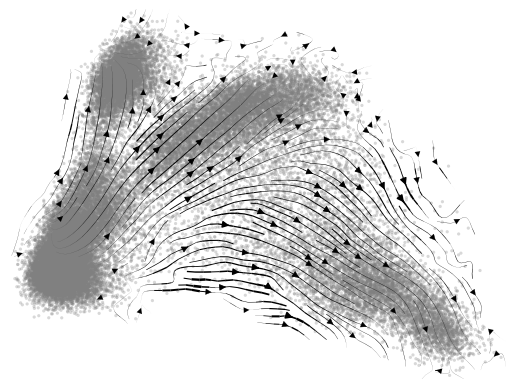

In [143]:
calculate_cellrank_vectorfield(adata)

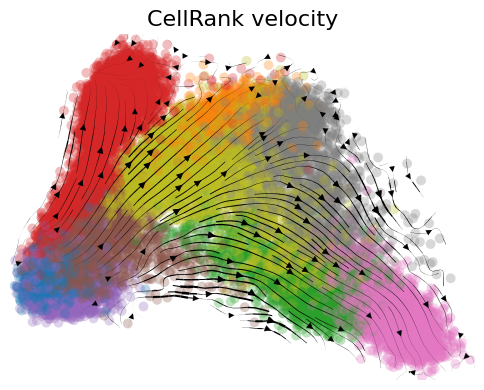

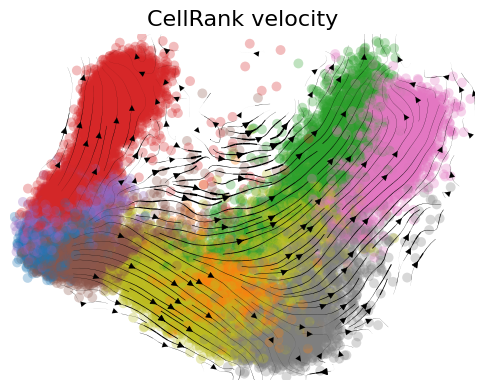

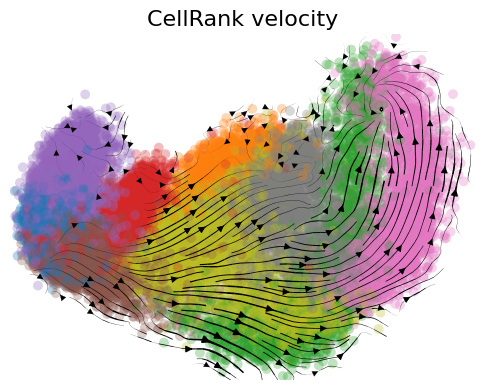

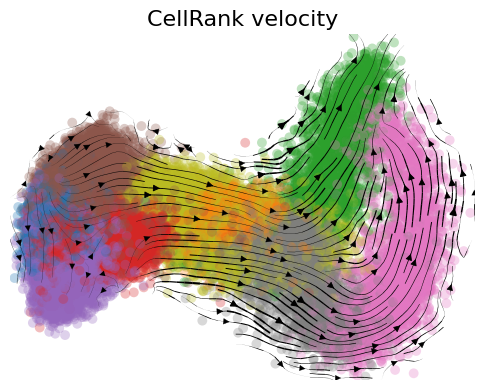

In [144]:
adata.uns["velocity_params"] = {'embeddings':'cr_pca'}

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,2'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.show()

fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,4'
)
plt.show()


fig = plt.figure(figsize=(6,4.5))

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank velocity",
    color='cell_annotation', 
    show=False,
    ax=ax,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,5'
)
plt.show()

This looks better.

In [145]:
adata.write_h5ad("../../data/benchmarking/maxi.h5ad")

# ...And now for splicing

We keep the same ground truths, we just update data objects.

In [3]:
adata0 = vt.pp.read("../../data/celltyped_adata_splicing.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

In [9]:
def process_splicing(adata0, reference_name):
    """
    load the labelling data, subset splicing data to same cells and genes,
    """
    assert 'spliced' in adata0.layers.keys(), 'this data has no splicing information'

    ref = sc.read_h5ad(f'../../data/benchmarking/{reference_name}.h5ad')
    
    adata = adata0[ref.obs_names, ref.var_names].copy()
    adata.obs = ref.obs
    adata.var = ref.var
    
    # this ensures we can map velocity to same space as benchmark data:
    adata.layers['total'] = ref.layers['total'].copy()
    adata.obsm['X_pca'] = ref.obsm['X_pca'].copy()
    adata.obsm['velocity_cr_pca'] = ref.obsm['velocity_cr_pca']
    if 'maxi' not in reference_name:
        adata.obsm['velocity_pst'] = ref.obsm['velocity_pst']

    s = adata.layers['spliced'].copy()
    u = adata.layers['unspliced'].copy()
    
    sc.pp.normalize_total(adata, layers=['spliced'], target_sum=None)
    sc.pp.normalize_total(adata, layers=['unspliced'], target_sum=None)

    adata.uns['raw_spliced_counts'] = s
    adata.uns['raw_unspliced_counts'] = u
    
    adata.write_h5ad(f'../../data/benchmarking/splicing_{reference_name}.h5ad')
    

In [10]:
dataset = ['mini_V3', 'mini_MN', 'mini_MD',
           'midi_NM', 'midi_Ne', 'maxi']

for ds in dataset:
    print(f'processing {ds}...')
    process_splicing(adata0, ds)
    print()
    
print('all done!')

processing mini_V3...

processing mini_MN...

processing mini_MD...

processing midi_NM...

processing midi_Ne...

processing maxi...

all done!


In [3]:
dataset = ['mini_V3', 'mini_MN', 'mini_MD',
           'midi_NM', 'midi_Ne', 'maxi']
for ds in dataset:
    ref = sc.read_h5ad(f'../../data/benchmarking/splicing_{ds}.h5ad')
    print(ref)

AnnData object with n_obs × n_vars = 6172 × 1275
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation', 't', 'seg', 'edge', 't_sd', 'milestones', 'leiden'
    uns: 'raw_spliced_counts', 'raw_unspliced_counts'
    obsm: 'X_pca', 'velocity_cr_pca', 'velocity_pst'
    layers: 'spliced', 'total', 'unspliced'
AnnData object with n_obs × n_vars = 6391 × 1249
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation', 't', 'seg', 'edge', 'milestones', 'leiden'
    uns: 'raw_spliced_counts', 'raw_unspliced_counts'
    obsm: 'X_pca', 'velocity_cr_pca

# Visualisation

In [156]:
adata0 = vt.pp.read("../../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


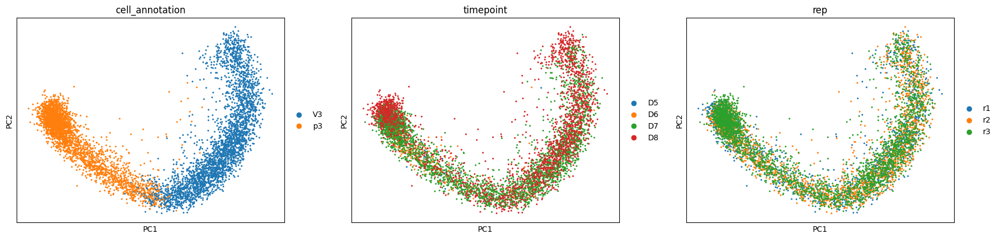

In [157]:
### 2. V3

types = ['V3', 'p3']

adata = adata0[[ct in types for ct in adata0.obs.cell_annotation]]

genes = vt.pp.select_genes(
    adata[adata.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

adata = vt.pp.size_normalize(
    adata, 
    genes=genes, 
    total_layer='total', 
    new_layer='new',
    unsparsify=True
)

adata = process_for_pseudotime(adata, 'total')

sc.pl.pca(adata, color=['cell_annotation','timepoint','rep'])

inferring a principal tree --> parameters used 
    200 principal points, sigma = 2, lambda = 100, metric = euclidean
    fitting:  19%|█▉        | 57/300 [00:08<00:34,  7.00it/s]
    converged
    finished (0:00:08) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.
Tips: [ 87 132]

Forks: []


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


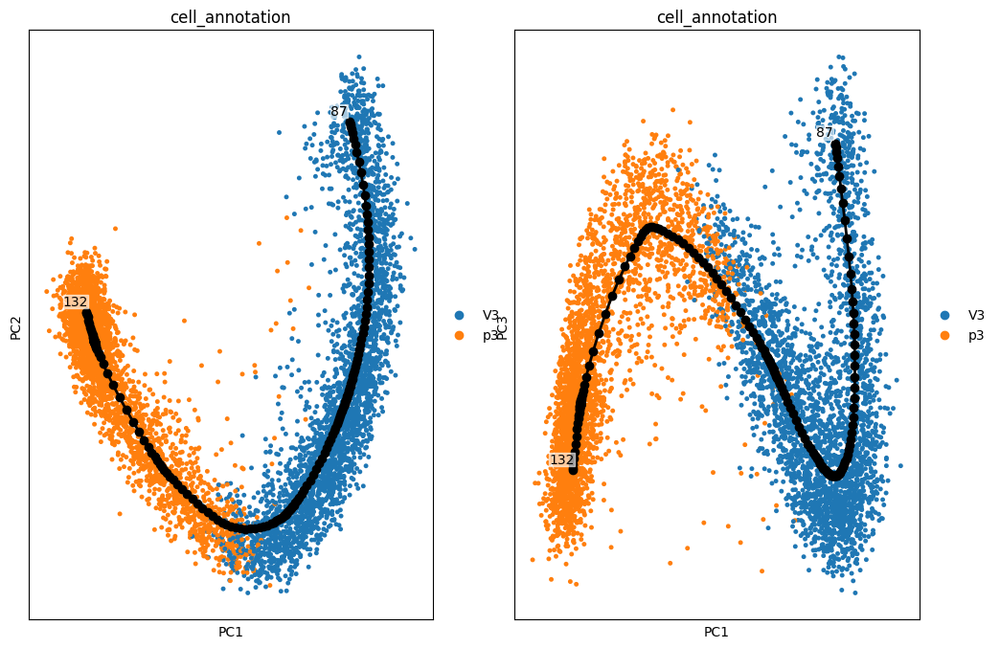

In [158]:
run_tree(
    adata, 
    'total',
    n_nodes=200,
    seed=1,
    ppt_lambda=100,
    ppt_sigma=2,
    ndims_rep=50,
    figsize=(12,8)
)

node 132 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    mappings: 100%|██████████| 10/10 [01:36<00:00,  9.63s/it]
    finished (0:01:39) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


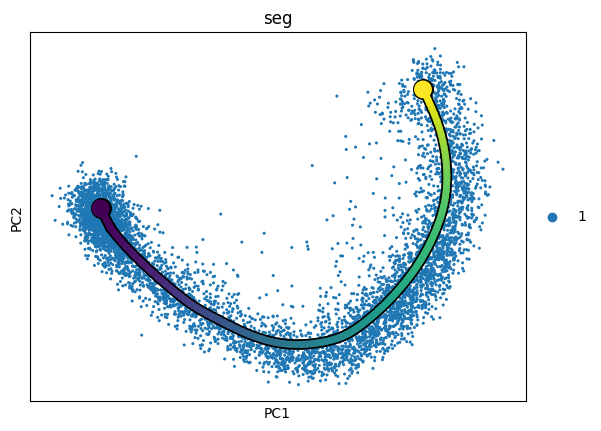

In [159]:
run_pseudotime(adata, root=132)

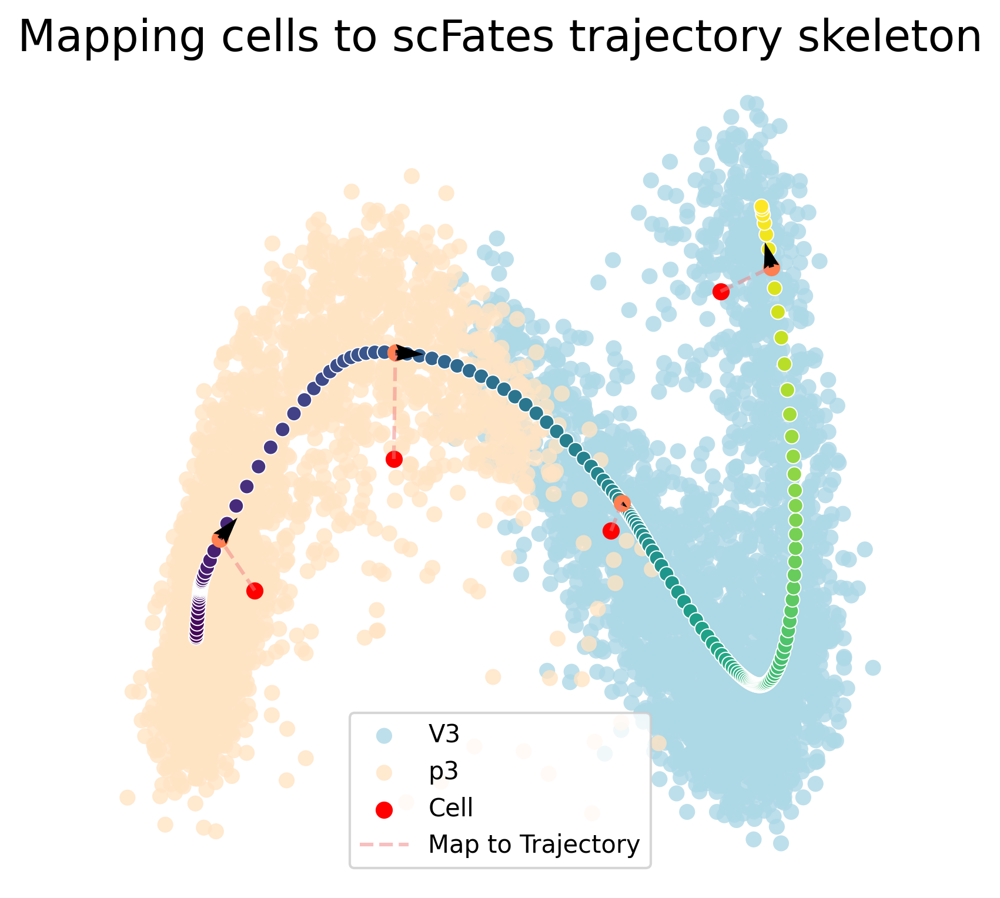

In [186]:
idx = adata.uns['graph']['pp_info'].sort_values('time').PP.values
points = adata.uns['graph']['F'].T[idx]
time = adata.uns['graph']['pp_info'].sort_values('time').time.values
segs = adata.uns['graph']['pp_info'].seg.values[idx]

adata2 = adata[idx,:]

fig = plt.figure(figsize=(6,6), dpi=300)
ax = fig.subplots()
sc.pl.scatter(adata, basis='pca', frameon=False, title='', components='1,3',
              ax=ax, color='cell_annotation', size=170, alpha=0.8,show=False, 
              palette={'lightblue':'p3','bisque':'V3'})
sns.scatterplot(x=points[:,0], y=points[:,2], hue=time, ax=ax, palette='viridis', legend=False)
ax.set_title('Mapping cells to scFates trajectory skeleton', fontsize=18)
for i, a in enumerate([19, 67, 150, 20]):
    try:
        cell = adata2[a]
        cell_rep = cell.obsm['X_pca'][:,[0,2]]
        cell_seg = cell.obs.seg.values[0]

        seg_points = points[segs==cell_seg][:,[0,2]]
        best = np.sqrt(np.sum((cell_rep - seg_points)**2, axis=1)).argmin()

        ax.scatter(seg_points[best,0], seg_points[best,1], c='coral')

        if i==0:
            ax.scatter(cell_rep[:,0], cell_rep[:,1], c='red', label='Cell')
        else:
            ax.scatter(cell_rep[:,0], cell_rep[:,1], c='red')
        if i==0:
            ax.plot([cell_rep[:,0][0],seg_points[best,0]], [cell_rep[:,1][0],seg_points[best,1]],
                    color='lightcoral', alpha=0.5, linestyle='--', label='Map to Trajectory')
        else:
            ax.plot([cell_rep[:,0][0],seg_points[best,0]], [cell_rep[:,1][0],seg_points[best,1]],
                    color='lightcoral', alpha=0.5, linestyle='--')
        ax.quiver(
            seg_points[best,0], 
            seg_points[best,1], 
            seg_points[best+1,0] - seg_points[best,0], 
            seg_points[best+1,1] - seg_points[best,1],
            width = .007, 
            headlength = 5,
            scale=3,
            scale_units='inches',
        )
    except IndexError:
        pass
plt.legend()
plt.savefig('../../figures/2.2.1_scFates_trajectory_visualisation.png', transparent=True)
plt.show()

In [187]:
calculate_pseudotime_vectorfield(adata)

100%|██████████| 6172/6172 [00:20<00:00, 296.39it/s]


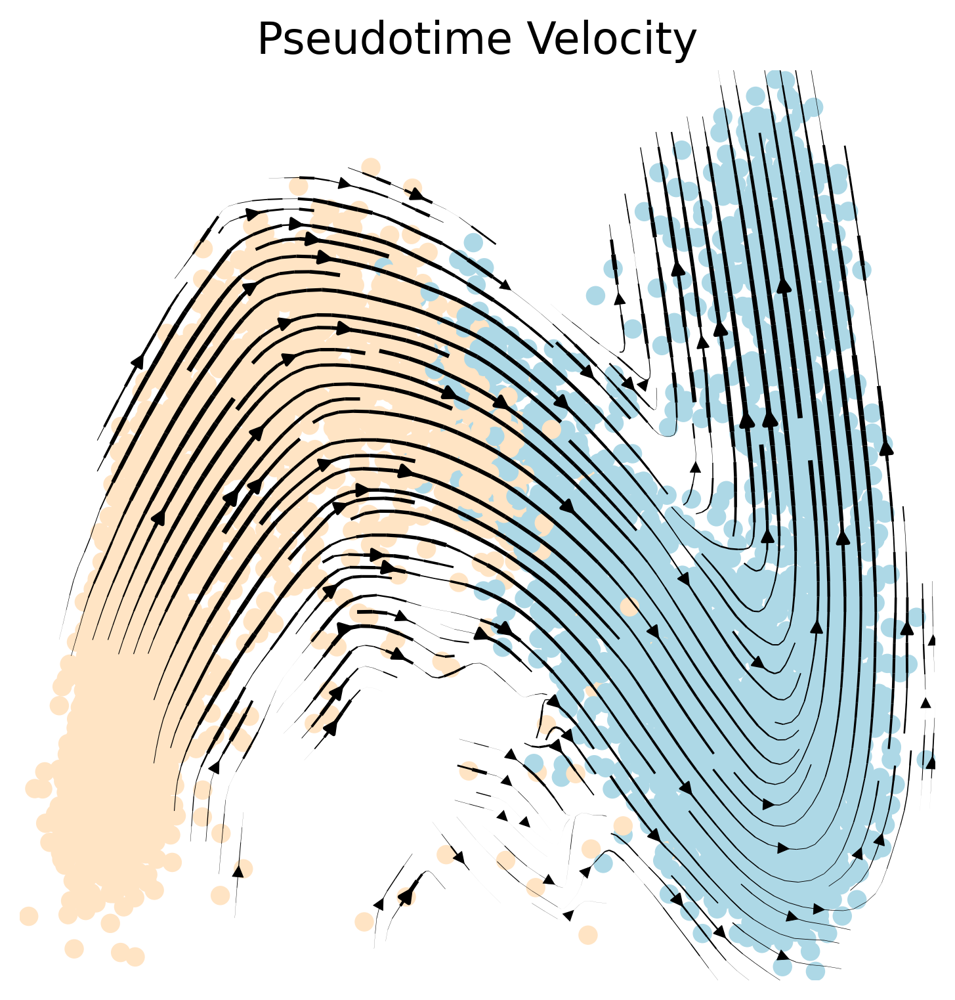

In [188]:
fig = plt.figure(figsize=(6,6), dpi=300)

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'pst'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='pst', 
    title="Pseudotime Velocity",
    color='cell_annotation', 
    show=False,
    ax=ax, alpha=1,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.savefig('../../figures/2.2.1.2_scFates_pseudotime_velocity.png', transparent=True)
plt.show()

  0%|          | 0/6172 [00:00<?, ?cell/s]

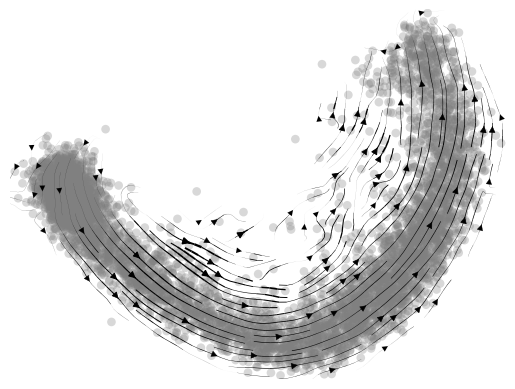

In [190]:
cnx = vt.pp.connectivities(total=adata.layers['total'], n_neighbors=30)
adata.obsp['neighbors_connectivities'] = cnx

pk = PseudotimeKernel(adata, time_key='t')

pk.compute_transition_matrix()

pk.plot_projection(basis='pca', key_added='velocity_cr')

adata.obsm['X_cr_pca'] = adata.obsm[f"X_pca"][:,:50]

In [191]:
adata.uns['velocity_graph'] = pk.transition_matrix

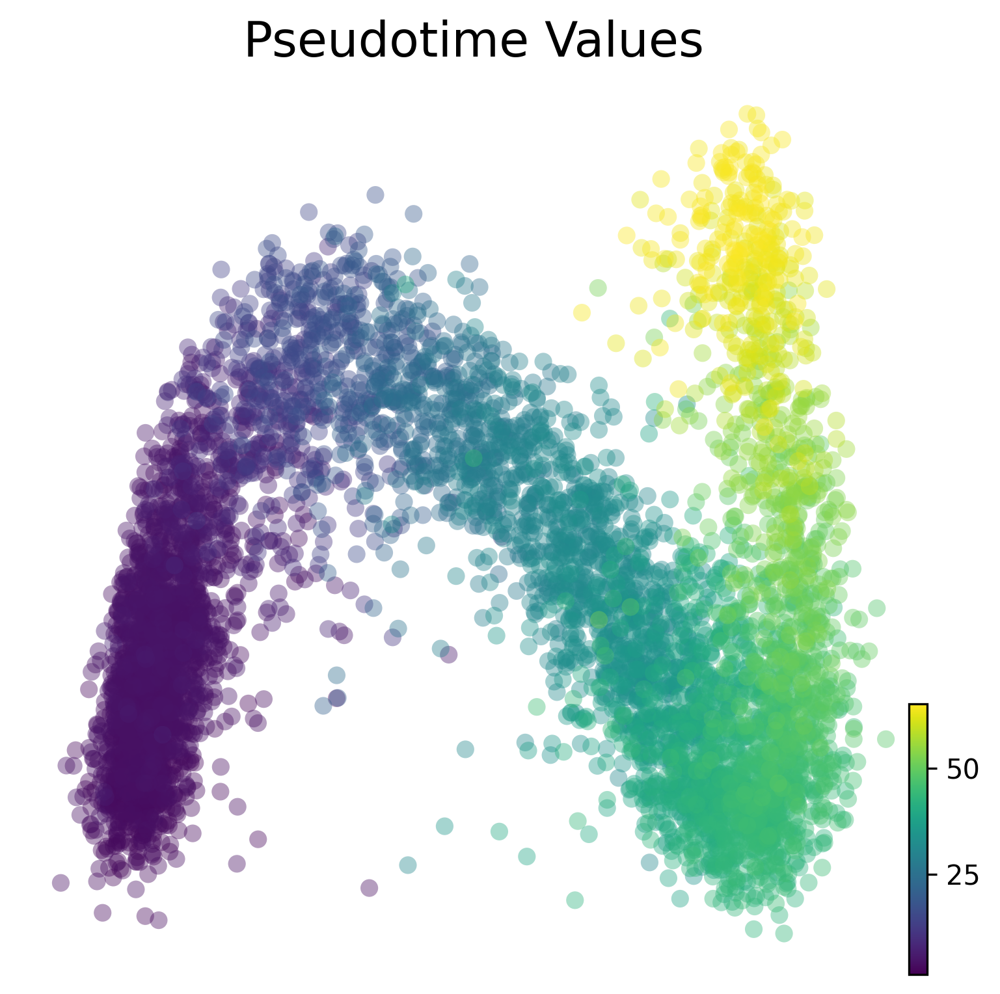

In [193]:
fig = plt.figure(figsize=(6,6), dpi=300)
ax = fig.subplots()
scv.pl.scatter(adata, basis='pca', frameon=False, title='', components='1,3',
              ax=ax, color='t', size=170, alpha=0.4, show=False)
ax.set_title('Pseudotime Values', fontsize=18)
plt.savefig('../../figures/2.2.1.3_scFates_pseudotime.png', transparent=True)
plt.show()

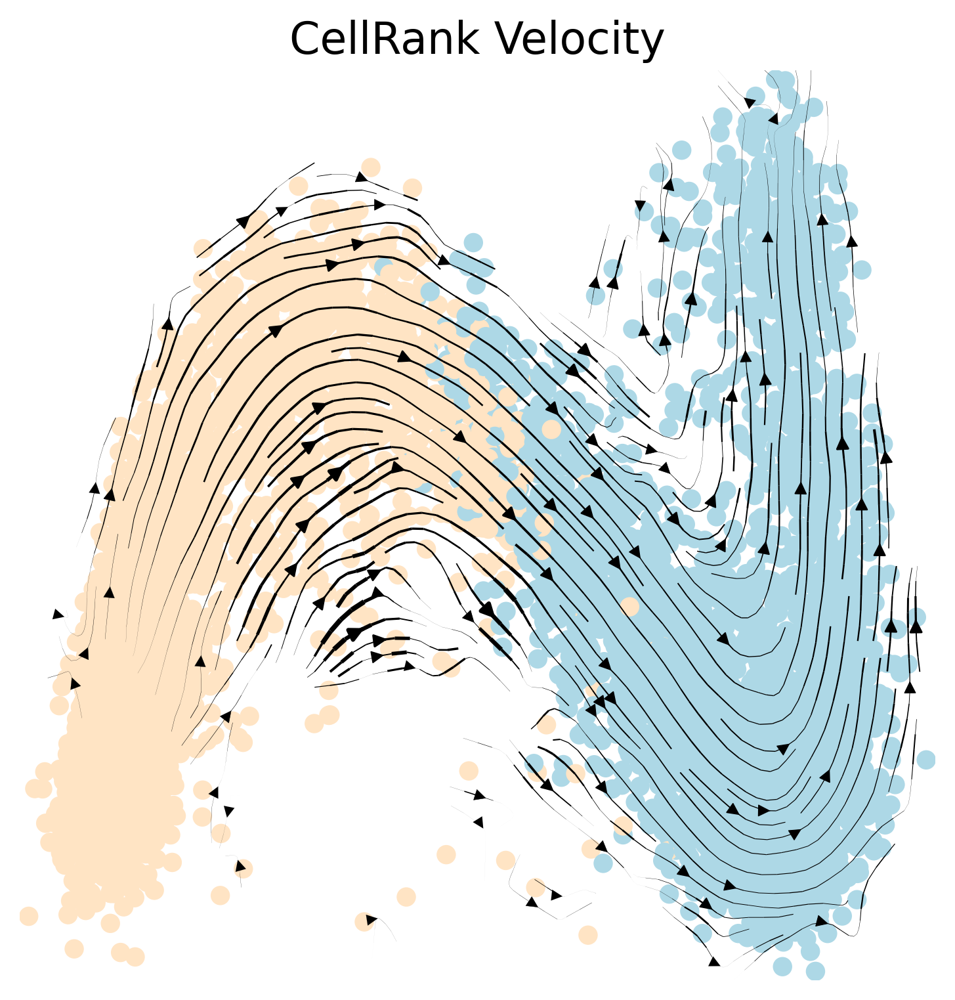

In [195]:
fig = plt.figure(figsize=(6,6), dpi=300)

ax = fig.subplots()

adata.uns["velocity_params"] = {'embeddings':'cr_pca'}
scv.pl.velocity_embedding_stream(
    adata, 
    basis='cr_pca', 
    title="CellRank Velocity",
    color='cell_annotation', 
    show=False,
    ax=ax, alpha=1,
    size=200,
    fontsize=16, 
    legend_loc=False, components='1,3'
)
plt.savefig('../../figures/2.2.1.4_CellRank_pseudotime.png', transparent=True)
plt.show()

# Setting up boundaries for CBD

In [ ]:
if self.name == "mini_MN":
    self.obs = 'leiden'
    self.cluster_edges = [
        ('0','2'),
        ('2','4'),
        ('2','3'),
        ('4','5'),
    ]
elif self.name == "mini_V3":
    self.obs = 'leiden'
    self.cluster_edges = [
        ('0','1'),
        ('1','3'),
        ('3','2'),
        ('2','4')
    ]
elif self.name == "mini_MD":
    self.obs = 'leiden'
    self.cluster_edges = [
        ('2','3'),
        ('3','0'),
        ('3','5'),
        ('0','1'),
        ('1','4'),
    ]

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


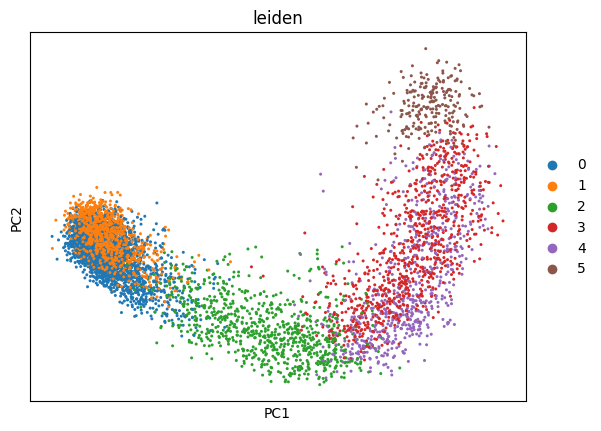

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


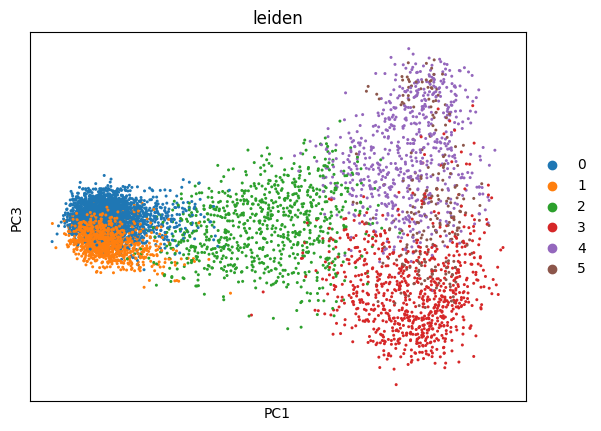

In [223]:
name = 'mini_MN'
adata = sc.read_h5ad(f'../../data/benchmarking/{name}.h5ad')

sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=.5)

sc.pl.pca(adata, color='leiden', components='1,2')
sc.pl.pca(adata, color='leiden', components='1,3')

In [224]:
name = 'mini_MN'

adata.write_h5ad(f'../../data/benchmarking/{name}.h5ad')

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


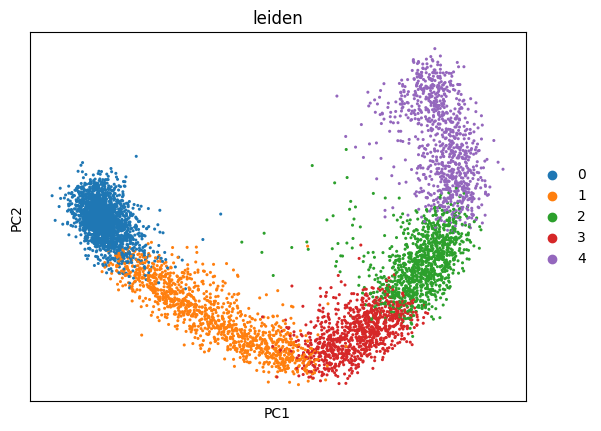

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


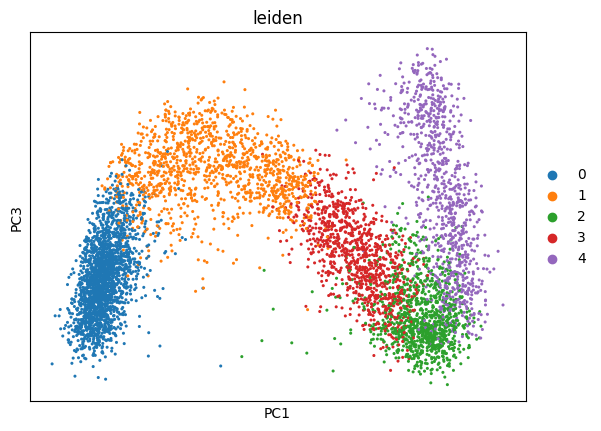

In [225]:
name = 'mini_V3'
adata = sc.read_h5ad(f'../../data/benchmarking/{name}.h5ad')

sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=.75)

sc.pl.pca(adata, color='leiden', components='1,2')
sc.pl.pca(adata, color='leiden', components='1,3')

In [226]:
name = 'mini_V3'
adata.write_h5ad(f'../../data/benchmarking/{name}.h5ad')

/camp/home/maizelr/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


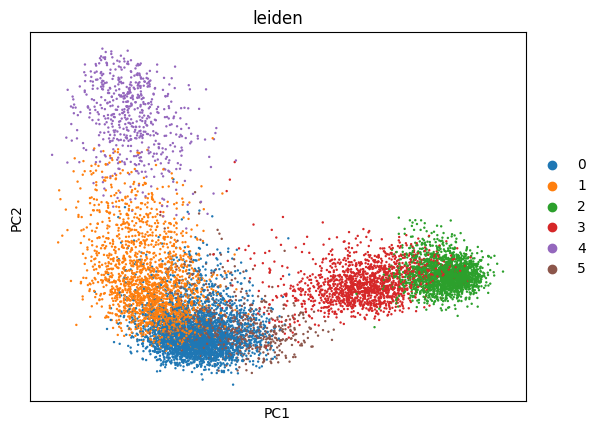

In [229]:
name = 'mini_MD'
adata = sc.read_h5ad(f'../../data/benchmarking/{name}.h5ad')

sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=.5)

sc.pl.pca(adata, color='leiden', components='1,2')


In [230]:
name = 'mini_MD'
adata.write_h5ad(f'../../data/benchmarking/{name}.h5ad')